# Single-molecule footprinting (SMF) Inference Models

This notebook and repository simulates EcoGII SMF data (methylating A/T) and has inference models using Turing.jl.

All data is simulated using idealised HK1 regulatory region as example. Here is the paper describing the regulatory region:

https://www.nature.com/articles/s41588-022-01204-x

![Variants fall into three groups at HK1 locus](../images/hk1_overview.png)


The image above depicts transcription factor binding sites within the regulatory region, this notebook is concerned with how to simulate and perform inference on the SMF data to determine how these three binding sites may be simultaneously occupied. However, I give a little background on that image below.

## Background
The image above depicts *de novo* variants in red below the sequence in black, the variants are sequence changes that lead to disease (each letter/deletion is a different individual). The variants fall into three groupsthe groups, that define three transcription factor binding sites. The binding sites here are described by transcription factor motifs, shown as the variable size coloured letters above the sequence. These describe the sequence preference of the transcription factor, the largest letter indicating the most preferred letter. These motifs match the sequence below (as identified by a likelihood ratio method described the the paper above), but match imperfectly. This visualisation of a transcription factors sequence preference is called a sequence logo:
https://en.wikipedia.org/wiki/Sequence_logo

The height of letter is dictated by uncertainty (Shannon entropy) of the base at position $i$ in the binding site. By laboratory means, we can identify all the binding sites of a factor in the genome, and then we can calculate the information content at a given position in the binding site (also described as a **motif**) by constructing a position weight matrix: https://en.wikipedia.org/wiki/Position_weight_matrix, which gives the frequency of A, C, G, T at each position.


To identify the binding sites or *motifs* above I determined which transcription factor family sequence preference or motif was most distrupted by each variant. There is a figure describing this in the above paper. I say transcription factor family as many members of the same family (NFATC1, NFATC2, ... are members of NFATC family, FOXA1, FOXA2 are members of FOXA family) bind the same DNA sequence, so from a DNA sequence perspective alone we do not know which family member.

### Biological and disease significance of the three binding sites
This regulatory region controls the repression of gene *HK1*. This gene must be silenced/repressed/not expressed (these are synonyms) in pancreatic beta-cells for normal cell function, if *HK1* is expressed it impacts glucose sensing leading to secretion of insulin at low levels of glucose. We know that any one of the variants (the changes in red above) are sufficient to cause a loss of *HK1* repression. The data on the right is a proxy for disease severity, in severe cases individuals have very large birth weights and are diagnosed at birth (the two are not independent of each other). We can see that group1 (NFATC) and group 3 (FOXA2) are associated with large birth weights and diagnosis at birth, whereas group 2 (NKX2) is associated with normal birth weight a diagnosis within the first two years of life. This is called a genotype-phenotype association. 

This and other data points to NFAT and FOXA being responsible for establishing repression and NKX2 for maintening the repression. We want to investigate this, so we need to know whether all three transcription factors bind the regulatory region simultanesouly or do they bind in combination.

This motivates the work we are doing in this notebook.


## Background on single molecule footprinting
Single molecule footprinting is also called Fiber-seq (https://www.science.org/doi/10.1126/science.aaz1646) SMAC-seq (https://www.nature.com/articles/s41592-019-0730-2), SAMOSA (SAMOSA-Tag paper https://www.nature.com/articles/s41588-024-01748-0), NOME-seq, nanoNOMe, and more.

We can use it to determine where transcription factors and nucleosomes are present on a molecule of DNA. We treat of cells with a methylatransferase that marks accessible base pairs, those not bound by a TF or in a nucleosome:

![SMF description](../images/smf_description.png)

We can detect this modification using Oxford Nanopore Technologies sequencing. In the above SAMOSA-Tag paper (which is a variant of SAMOSA) it has a nice image:

![SAMOSA-Tag](../images/samosa.png)

Ignore the Tagmentation Tn5 parts of the image, this is an added sophistication to fragment DNA.

### Stranded reads
An important consideration is that we may sequence the forward or reverse strand of region or the genome.
Consider the following double stranded DNA:
```
5'-ACGTGATTAGCGCGCATG-3' ## forward
3'-TGCACTAATCGCGCGTAC-5' ## reverse
```

If we happen to measure the forward strand we can obtain information at the forward As:
```
5'-ACGTGATTAGCGCGCATG-3' ## forward
5'-A----A--A------A---3' ## informative positions
```
The we obtain information at different positions for the reverse strand, the reverse As (or the forward Ts')
```
5'-ACGTGATTAGCGCGCATG-3' ## forward
3'-TGCACTAATCGCGCGTAC-5' ## reverse
3'----A--AA--------A--5' ## informative positions
5'----T--TT--------T--3' ## informative positions T view
```

Although the A is the base that is methylated, as we align the reads to an arbitrary strand of the genome, we tend to talk about data at forward read As and reverse read Ts (the Ts being the Ts on the forward strand).


## Other types of footprinting

We can methylate DNA in a difference context from A → 6mA. We can also mark the dinucleotide GpC, the *p* means a G and C on the same strand with direction G -> C:

![GpC SMF description](../images/gpc_smf.png)

The methylation at GC sites is of the cytosine C -> 5mC. Note that wenow encounter endogenous or natural DNA methylation that occurs in cells at CpG sites. The methylation is still at C -> 5mC. So natually existing methylation is CG -> 5mCG, but we can induce methylation at GC -> 5mGC. We refer to these as CpG and GpC, because the strand and direction are important. If we did not think about strand and direction we may think a CG site is opposite a GC site. However, when we consider strand a CG is *reverse complement* to a CG and a GC is *reverse complement* to a GC. Look up reverse complement if this is not clear. What is more exciting is that the two dinucleotides CG and GC occur with different frequencies in the genome: CGs every ~100bp and GCs ever ~25bp on average.

When we measure DNA methylation we measure all instances of 5mC! After the measurement we have to disambiguate based on the sequence. Lets look at an example.


```
            1         2    ## position tens 
   12345678901234567890    ## position units
5'-ACGTGATGCTAGCGCGCATG-3' ## forward
3'-TGCACTACGATCGCGCGTAG-5' ## reverse
   
5'--CG----GC--GCGCGC----3' ## forward potentially methylated positions showing CG/GC dinucleotides
5'--C------C---C-C-C----3' ## forward potentially methylated positions showing cytosines

3'--GC----CG--CGCGCG----5' ## reverse potentially methylated positions showing CG/GC dinucleotides
3'---C----C---C-C-C-----5' ## reverse potentially methylated positions showing cytosines
```

Note that although the dinucleotides on the forward and reverse strands occupy the same positions, so we get the same information independent of strand which is different to the 6mA. For 5mC methylation the Cs are offset by one from forward to reverse, but the dinucleotides are not.

To interpret the above methylation, consider the forward strand. If we go left to right we have:
  1. `Position  2` `C` is part of `CG` measurement will be of endogenous methylation
  2. `Position  9` `C` is part of `GC` measurement will be of induced methylation
  3. `Position 13` `C` is part of `CG` part of both a `CG` and a `GC` methylation is ambigous! If this cytosine is methylated we cannot determine the origin!
  4. `Position 15` `C` is part of `GCG` part of both a `CG` and a `GC` methylation is ambigous! Same as 13.
  5. `Position 17` `C` is part of `GC` measurement will be of induced methylation
  
In this notebook we only deal with 6mA methylation, in future these simulation and inference models should be extended to GC methylation.



## Notebook objective

We need to build inference models to understand the configurations in which transcription factors can bind. To help this we will simulate idealised SMF data over the HK1 regulatory region.



In [1]:
include("../src/project.jl")
theme(:wong2)

In [2]:
### load a description of the HK1 locus, including its coordinates on the genome, sequence, and a table of the motifs
hk1desc = load_seq_motif()

(chrom = "chr10", loc = 71108610:71108717, seq = "CATTTCCCGCAGGCAGAGTTTTTGCTTGCCCTGTATTCCAGCACAGGCTGGTACTCGAGACACATCTGTCCTGTGTTTGTTTTCCATTATTTGCTGGTAATAATGGCT", motifs = 3×8 DataFrame
 Row │ chrom    start     stop      name     seq        valid  rstart  rstop 
     │ String7  Int64     Int64     String7  String15   Bool   Int64   Int64 
─────┼───────────────────────────────────────────────────────────────────────
   1 │ chr10    71108643  71108649  NFAT     TATTCCA    false      34     40
   2 │ chr10    71108660  71108668  NKX2     GTACTCGAG  false      51     59
   3 │ chr10    71108683  71108689  FOX      TGTTTGT    false      74     80)

## Binding states

To understand how transcription factors may bind in combination, its useful to have a description of binding states. If we have $n$ transcription factors, then there are $2^n$ states.

Whenver we perform an experiment we normally measure $10^6$ cells, multiple states may be present in these cells and we want to simulate and infer their proportions. 

In [3]:
"""
    bindingconfig(desc, config)
    
    Adds a binding configuration to a problem description, if the problem contains n motifs, then the total number of bound states is 2^n.

    `config` is a vector of pairs (s_i, p_i) where s_i is the state number and p_i is its probability

    e.g for 3 motifs:
    StateNumber    State
        0        [0, 0, 0]       # no TFs bound
        1        [1, 0, 0]       # Only a TF bound at binding motif 1
        2        [0, 1, 0]        .
        3        [1, 1, 0]        .
        4        [0, 0, 1]        .
        5        [1, 0, 1]       # 1 and 3 bound
        6        [0, 1, 1]        .
        7        [1, 1, 1]       # all bound

"""
function bindingconfig(desc, config)
   
    m = 2^size(desc.motifs, 1) - 1### max config
    states = first.(config)
    @assert all(s -> 0 <= s <= m, states)
    probs = last.(config)
    @assert all(p -> 0 <= p <= m, probs)
    
    (; desc..., states, probs)
end

bindingconfig

In [4]:
### annotate the hk1 region with a binding configuration
hk1bindingdesc = bindingconfig(hk1desc, [(3, 0.25), (5, 0.25), (7, 0.5)])

(chrom = "chr10", loc = 71108610:71108717, seq = "CATTTCCCGCAGGCAGAGTTTTTGCTTGCCCTGTATTCCAGCACAGGCTGGTACTCGAGACACATCTGTCCTGTGTTTGTTTTCCATTATTTGCTGGTAATAATGGCT", motifs = 3×8 DataFrame
 Row │ chrom    start     stop      name     seq        valid  rstart  rstop 
     │ String7  Int64     Int64     String7  String15   Bool   Int64   Int64 
─────┼───────────────────────────────────────────────────────────────────────
   1 │ chr10    71108643  71108649  NFAT     TATTCCA    false      34     40
   2 │ chr10    71108660  71108668  NKX2     GTACTCGAG  false      51     59
   3 │ chr10    71108683  71108689  FOX      TGTTTGT    false      74     80, states = [3, 5, 7], probs = [0.25, 0.25, 0.5])

# Sampling SMF data

Given a description of the regulatory region + a binding description of which states are present and at what rate. We similate off either strand at As for forward reads and Ts for reverse reads.

In [5]:
"""
    sample_smf_data(tf_footprints, seq, nreads=10, open_meth_prob=0.9, closed_meth_prob=0.05, fwprob=0.5)

    Sample methylation data from a sequence with a given number of reads, and a given probability of methylation for open and closed sites.

"""
function sample_smf_AT(desc; nreads=10, open_meth_prob=0.9, closed_meth_prob=0.05, frprob=0.5)

    fi_A = findall('A', desc.seq)
    fi_T = findall('T', desc.seq)
    
    ### build dictionary of states indexes to bound tfs
    ### e.g Dict(0 => [], 1 => [1], 2 => [2], 3 => [1, 2], ..., 7 => [1, 2, 3])
    state_dict = Dict(k => Set(findall(digits(k, base=2, pad=size(desc.motifs, 1)) .== 1)) for k = 0:(2^size(desc.motifs, 1) - 1))
    ### determine which of the footprints are in use in this sample
    bound_tfs = sort!(unique(mapreduce(s -> collect(state_dict[s]), vcat, desc.states)))
    

    ### which of the As/Ts are within a motif
    a_in_motif = [index_in_motif(i, desc.motifs.rstart[bound_tfs], desc.motifs.rstop[bound_tfs], bound_tfs) for i in fi_A]
    t_in_motif = [index_in_motif(i, desc.motifs.rstart[bound_tfs], desc.motifs.rstop[bound_tfs], bound_tfs) for i in fi_T]

    ### sample the strands and the states for each read 
    sample_strands = rand(Bernoulli(frprob), nreads)
    sample_states  = desc.states[rand(Categorical(desc.probs), nreads)]
    
    ### reads are stored as bitarray of methylated bases true for meth, false for no meth
    sample_reads = BitArray{1}[]
    
    for (strand, state) in zip(sample_strands, sample_states)
        state_desc = state_dict[state] ### state of this read
        base_in_motif = strand ? a_in_motif : t_in_motif ### strand of this read
        sample_read = rand.(Bernoulli.(ifelse.(base_in_motif .∈ Ref(state_desc), closed_meth_prob, open_meth_prob))) ## sample the occcupied footprint
        push!(sample_reads, sample_read) 
    end
    
    
    (;fi_A, fi_T, a_in_motif, t_in_motif, sample_strands, sample_states, sample_reads, bound_tfs, desc)
    
end

### helper function to return which motif a given base pair index is in.
function index_in_motif(i, starts, stops, bound_tfs)
    for (k, (s, e)) in enumerate(zip(starts, stops))
        (s <= i <= e) && return bound_tfs[k]
    end
    return 0
end

index_in_motif (generic function with 1 method)

### Plotting and helper functions

These should really be in files in the repo, but useful to see them in the notebook.

In [6]:

## plot where TF motifs are given a description
function plotdescription(desc; y=1, lw=10, kwargs...)
    p = plot()
    
    for (k, (s, e)) in enumerate(zip(desc.motifs.rstart, desc.motifs.rstop))
       plot!([s, e], [y, y], lab="TF Motif $k", c=k, lw=lw; kwargs...) 
    end
    p
end

## plot simulated SMF reads grouping by state (labelled group here) or strand
function plotreads!(sample; offset = 0, group=nothing, sort=nothing)
    
    if isnothing(sort)
        si = 1:length(sample.sample_reads)
    elseif sort == :strand
        si = sortperm(sample.sample_strands)
    elseif sort == :state
        si = sortperm(sample.sample_states)
    end
        
    labels = Set{String}()
        
    for (k, i) = enumerate(si)
        
        ind = sample.sample_strands[i] ? sample.fi_A : sample.fi_T
        if isnothing(group)
            c = :black
            l = "SMF Reads"
        elseif group == :strand
            c = sample.sample_strands[i] + 1
            l = ifelse(sample.sample_strands[i], "+ | A", "- | T")
        elseif group == :state
            c = sample.sample_states[i]
            l = string("S", c)
        end
        if l ∈ labels
            ll = ""
        else
            ll = l
            push!(labels, l)
        end
        scatter!(ind[sample.sample_reads[i]], fill(k + offset, sum(sample.sample_reads[i])), marker=(:vline, 5), c=c, lab="",)
        plot!([ind[1], ind[end]], [k+offset, k+offset], c=c, lab=ll)
    end
    plot!(ylabel="Reads")
end

## function to layout multiple plots for a sample
function plot_AT_samples(sample; group=nothing, sort=group)
    
    # top plot
    pr = plot(leg=:outertopright, xaxis=false, bottom_margin=-4mm)
    plotreads!(sample, group=group, sort=sort)
    
    # middle plot
    pm = plot(mean_meth(sample)..., ylabel="Proportion", lab="Mean Meth.", leg=:outertopright, marker=:circle, bottom_margin=0mm, top_margin=-3mm, fill=0, fillalpha=0.1, xaxis=false)
    plot!(leg=:outertopright, xticks=false)

    # bottom plot
    pd = plotdescription(sample.desc)
    scatter!(sample.fi_A, 3.0.*ones(size(sample.fi_A)), marker=:square, lab="A")
    scatter!(sample.fi_T, 5.0.*ones(size(sample.fi_A)), marker=:square, lab="T")
    plot!(leg=:outertopright, top_margin=-2mm, ylims=(-1, 6), yaxis=false)

    plot(pr, pm, pd, layout=grid(3, 1, heights=[0.8, 0.1, 0.1]), link=:x, grid=false, size=(1000, 700), fontfamily="helvetica", left_margin=5mm)

end


### function to aggregate the methylation per base pair
function total_meth(sample)
    meth_f = zeros(Int, length(sample.fi_A))
    meth_r = zeros(Int, length(sample.fi_T))

    tA = 0
    tT = 0
    for i = 1:length(sample.sample_reads)
        
        if sample.sample_strands[i]
            meth_f .+= sample.sample_reads[i]
            tA +=1
        else
            meth_r .+= sample.sample_reads[i]
            tT += 1
        end
        
    end
    
    meth = [meth_f ; meth_r]
    total = [fill(tA, length(meth_f)) ; fill(tT, length(meth_r))]
    mc = [sample.fi_A ; sample.fi_T]
    
    si = sortperm(mc)

    mc[si], total[si], meth[si]
end

function mean_meth(sample)
    pos, total, meth = total_meth(sample)
    pos, meth./total
end


mean_meth (generic function with 1 method)

## Setup configurations to sample SMF reads


Below are examples of different configurations of binding sites to explain how the binding configs work

In [7]:
config_tf1 = [(1, 1.0)] # sample state 1 = 100 with prob 1
config_tf2 = [(2, 1.0)] # sample state 2 = 010 with prob 1
config_tf3 = [(4, 1.0)] # sample state 4 = 001 with prob 1
config_all = [(7, 1.0)] # sample state 7 = 111 with prob 1
config_tf1_tf2_tf3 = [(1, 1/3), (2, 1/3), (4, 1/3)] ### sample states 1, 2, 3 each with prob 1/3
config_5 = [(5, 1.0)] # sample state 7 = 111 with prob 1
## two biologically more representative configurations
config_56  = [(0, 0.1), (5, 0.4), (6, 0.5)] # sample state 0 = 000 (no binding) prob 0.1, state 5 = 101 with prob 0.4, and state 6 = 011, with prob 0.5
config_57  = [(0, 0.1), (5, 0.4), (7, 0.5)] # sample state 0 = 000 (no binding) prob 0.1, state 5 = 101 with prob 0.4, and state 7 = 111, with prob 0.5
### parameters
nreads = 150
open_meth_prob = 0.8 ## probability of methylation if base pair is not bound (accessible)
closed_meth_prob = 0.1 ## probabilty of methylation if base pair is bound  (not accesible)
frprob = 0.5; ## probabilty of sampling forward or reverse strand


## Sample and plot!

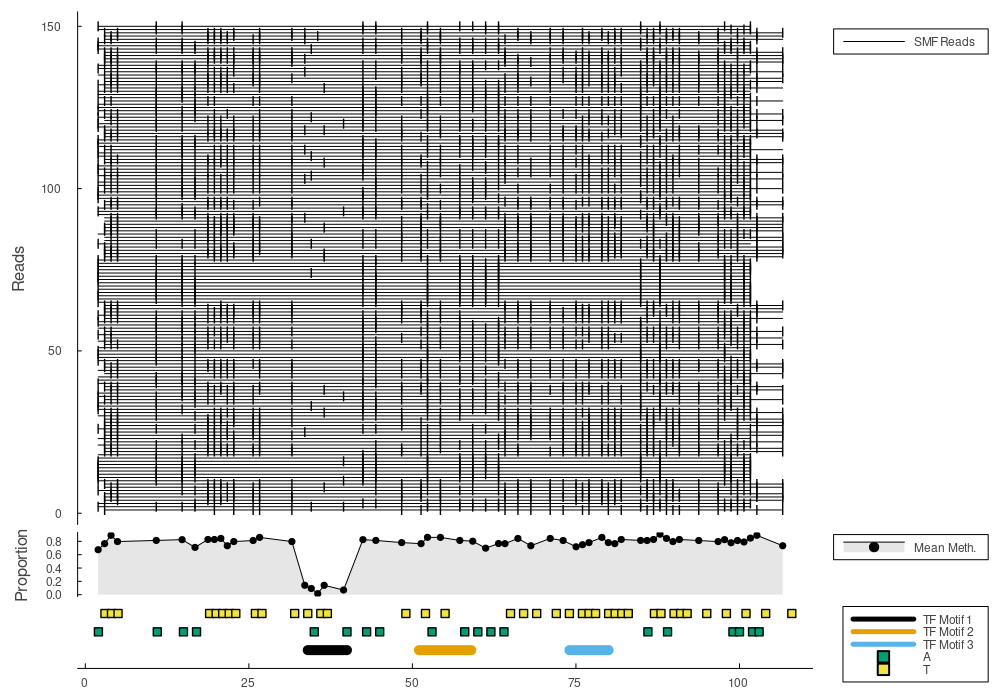

In [8]:
## first example just has tf 1 bound
smf_sample = sample_smf_AT(bindingconfig(hk1desc, config_tf1), nreads=nreads, open_meth_prob=open_meth_prob, closed_meth_prob=closed_meth_prob, frprob=frprob);
plot_AT_samples(smf_sample)

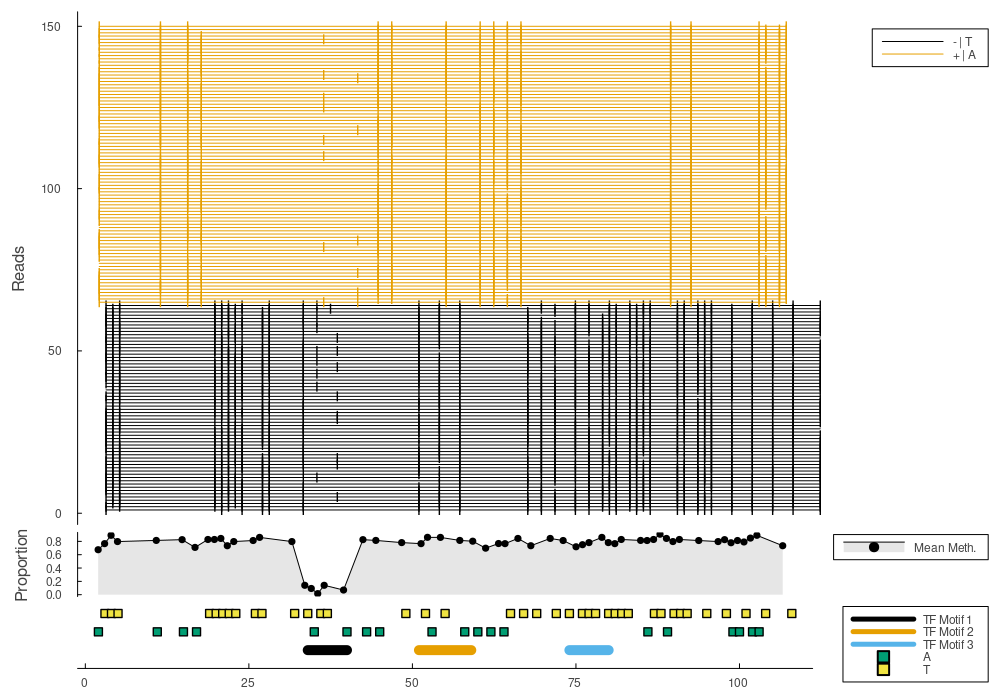

In [9]:
## we can plot grouping by the strand of the read
plot_AT_samples(smf_sample, group=:strand)

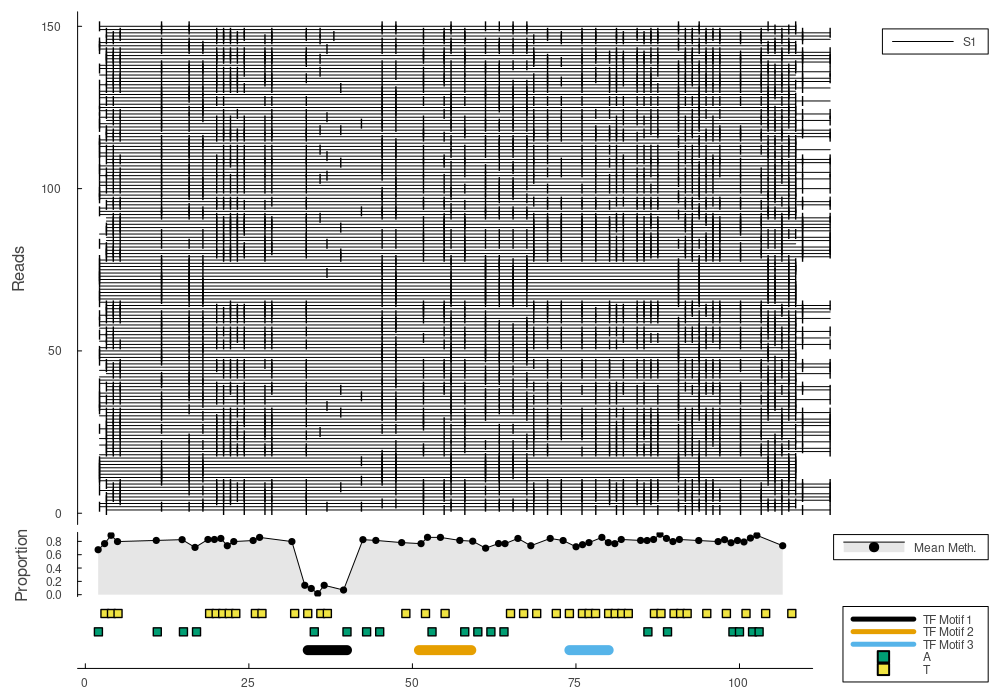

In [10]:
## we can plot grouping by the state of the read, in this case there is only one state
plot_AT_samples(smf_sample, group=:state)

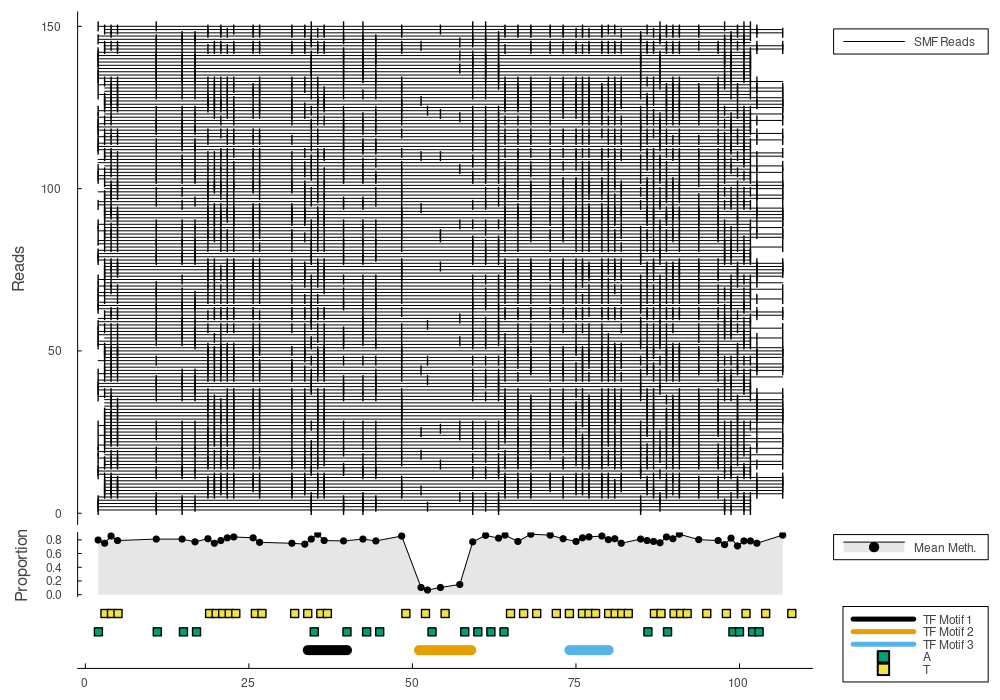

In [11]:
smf_sample = sample_smf_AT(bindingconfig(hk1desc, config_tf2), nreads=nreads, open_meth_prob=open_meth_prob, closed_meth_prob=closed_meth_prob, frprob=frprob);
plot_AT_samples(smf_sample)

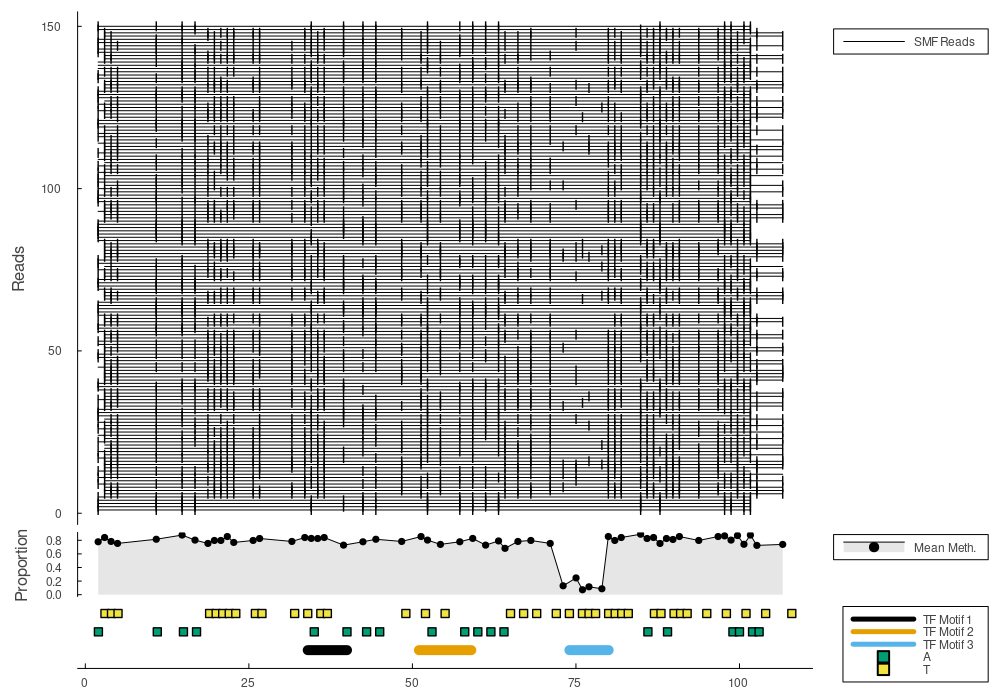

In [12]:
smf_sample = sample_smf_AT(bindingconfig(hk1desc, config_tf3), nreads=nreads, open_meth_prob=open_meth_prob, closed_meth_prob=closed_meth_prob, frprob=frprob);
plot_AT_samples(smf_sample)

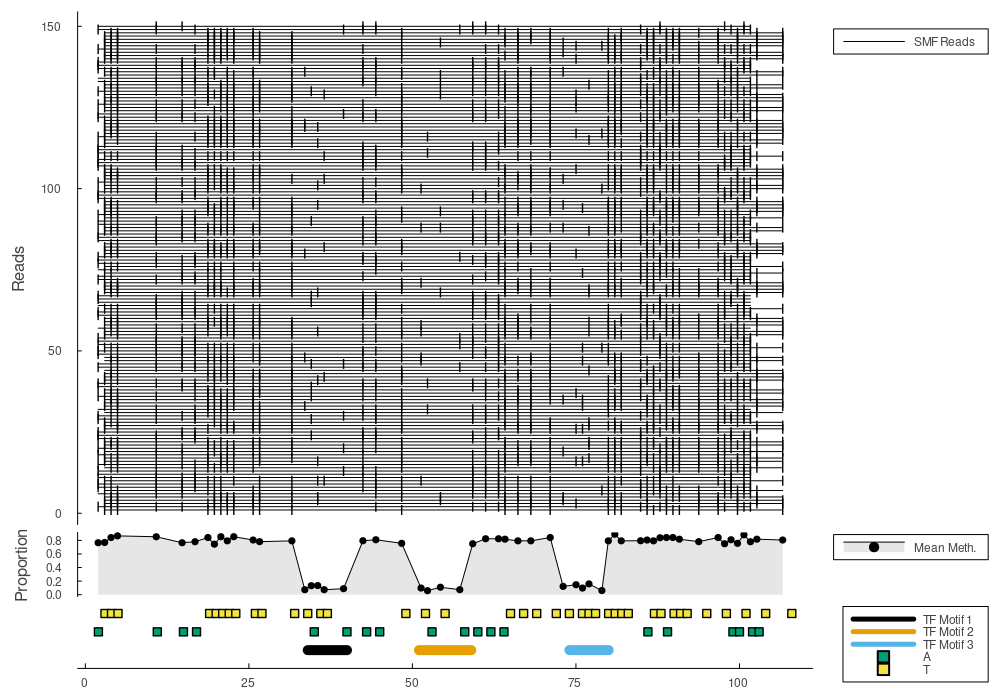

In [13]:
smf_sample = sample_smf_AT(bindingconfig(hk1desc, config_all), nreads=nreads, open_meth_prob=open_meth_prob, closed_meth_prob=closed_meth_prob, frprob=frprob);
plot_AT_samples(smf_sample)

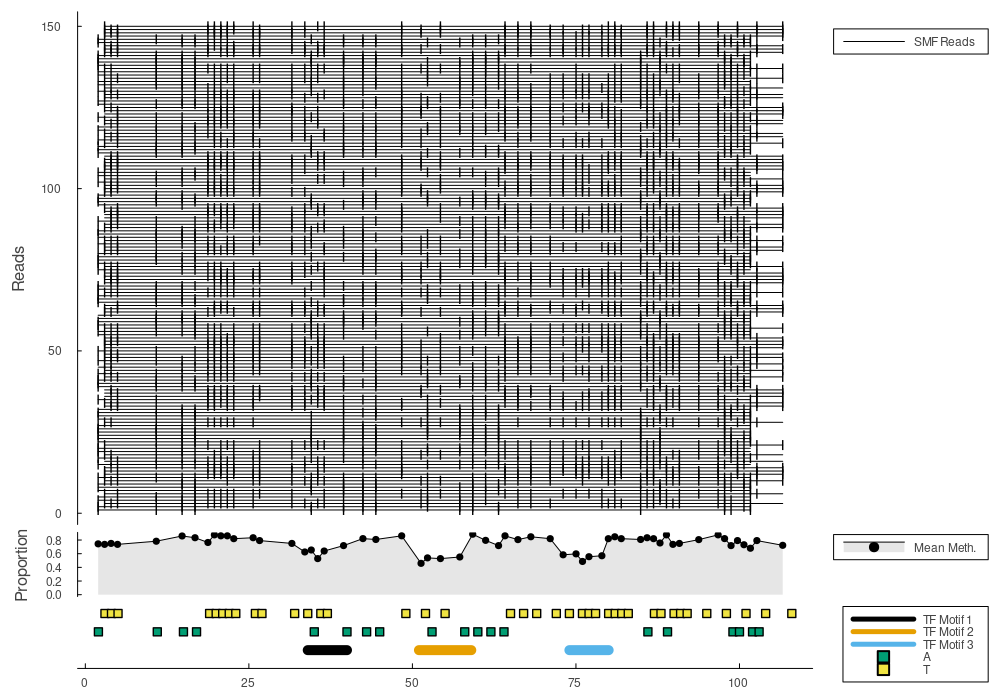

In [14]:
### now a sample of a mix of several states, the depths of the footprints are reduced
smf_sample = sample_smf_AT(bindingconfig(hk1desc, config_tf1_tf2_tf3), nreads=150, open_meth_prob=open_meth_prob, closed_meth_prob=closed_meth_prob, frprob=frprob);
plot_AT_samples(smf_sample)

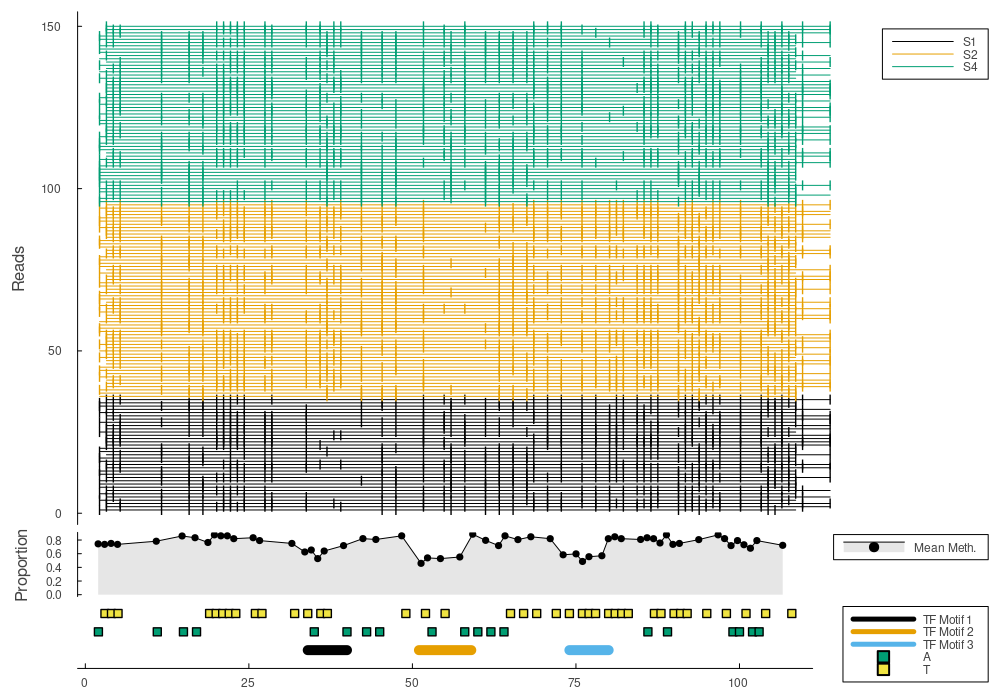

In [15]:
### plot now organised by state
plot_AT_samples(smf_sample, group=:state)

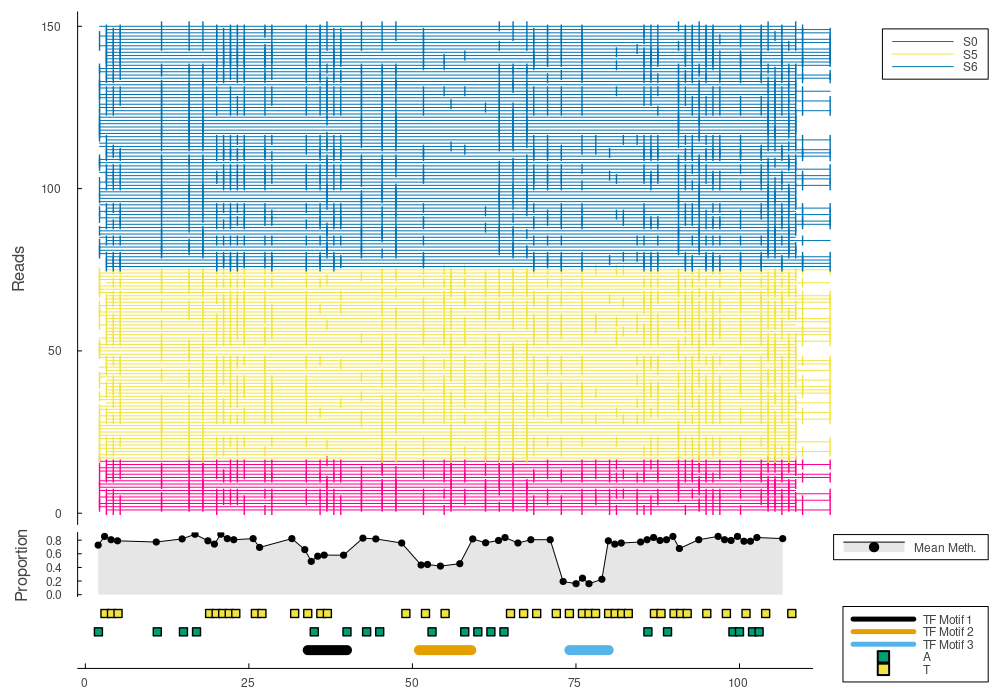

In [16]:
### now a sample of a mix of several states, the depths of the footprints are reduced
smf_sample = sample_smf_AT(bindingconfig(hk1desc, config_56), nreads=150, open_meth_prob=open_meth_prob, closed_meth_prob=closed_meth_prob, frprob=frprob);
plot_AT_samples(smf_sample, group=:state)

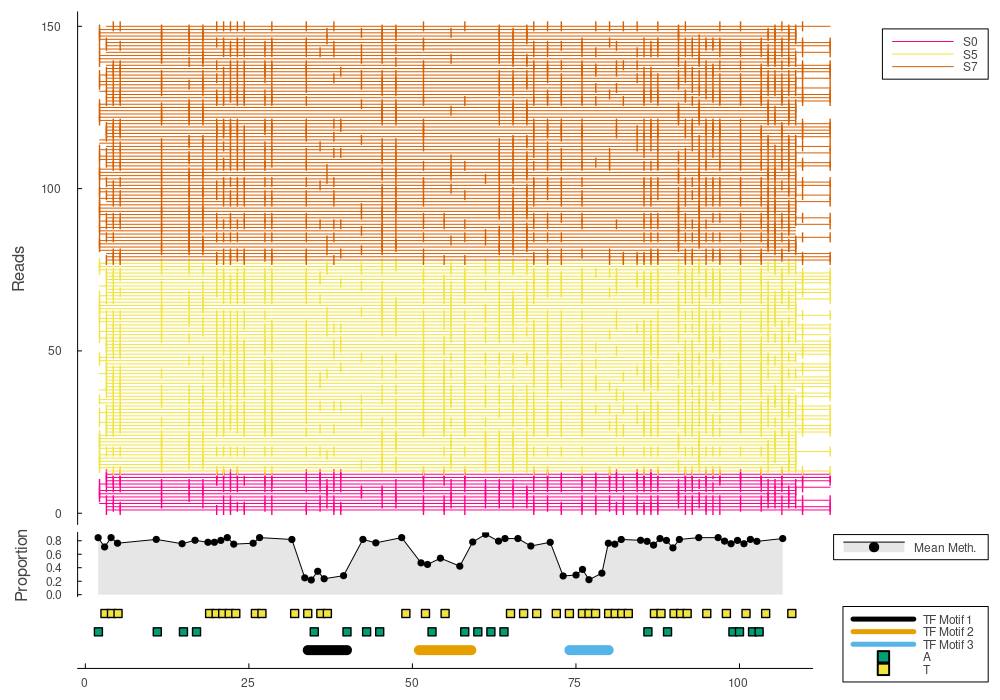

In [17]:
### now a sample of a mix of several states, the depths of the footprints are reduced
open_meth_prob = 0.8
closed_meth_prob = 0.2
smf_sample = sample_smf_AT(bindingconfig(hk1desc, config_57), nreads=150, open_meth_prob=open_meth_prob, closed_meth_prob=closed_meth_prob, frprob=frprob);
plot_AT_samples(smf_sample, group=:state)

# Turing.jl inference models of the sampled SMF data

For real data we do not know:
  1. The classes present, their propensities, and the locations of the footprints per state
  2. The open methylation probability, the closed methylation probability
  3. Here we are assuming that transcription factors are either bound or not for each state, in reality each transcription factor will be bound with a probability thatmay be different for each state.
  

Our objective eventually is to build inference models that will infer the state descriptions (in terms of footprint locations), propensities, and open and closed methylation probabilities.


However, we will start with simple models and build their complexity, by building models of:

  1. The mean methylation rate, assuming the footprint locations are known, but we will model the depths of the footprints and open methylation rate
  2. Infer the footprint locations and a different methylation rate per footprint (partially complete)
  3. Infer the states present, each state defined by a set of footprint locations, and the state propensity (TODO, see https://github.com/owensnick/NucleosomeInference.jl for nucleosome examples with chemical cleavage data).
  

### Helper function to calculate useful stats and helper variables for the inference

The first models will discard the state level information and just infer different methylation rates associated with each footprint

In [18]:
### the mean meth rate combines information on forward and reverse strands where the A's are in different positions


function smf_sample_stats(smf_sample)
    
    ### the mean meth rate combines information on forward and reverse strands where the A's are in different positions
    positions, total, totalmeth = total_meth(smf_sample) ## calculate mean meth rate
    methrate = totalmeth./total
    
    ### calculate some useful variables marking the footprints
    ### the positions variable above tells us where the methylated positions are but has thrown away which is an A and which is a T
    ### recalculate some of this information for helper
    mc = [smf_sample.fi_A ; smf_sample.fi_T]  ### mc gives the methylated positions of As followed by that of Ts
    si = sortperm(mc)
    ## Note: mc[si] == positions variable above, this is the genomic positions where we get information
    
    ## which of these positions are As or Ts
    atind = [fill(1, size(smf_sample.fi_A)) ; fill(2, size(smf_sample.fi_T))][si] ### note reordering by si
    
    
    

    ### useful locations of footprints
    footprints = [smf_sample.a_in_motif ; smf_sample.t_in_motif][si]
    footprintids = filter(!iszero, unique(footprints))
    footprint_locations = [extrema(findall(footprints .== i)) for i in footprintids]
    
    (; footprints, footprintids, footprint_locations, atind, positions, total, totalmeth, methrate, smf_sample)
    
end


function plot_footprint_level_sample(sample)
    
    pt = bar(sample.positions, sample.methrate, group=sample.atind, lab=["A" "T"], title="Mean Meth Rate at genome positions", line=stroke(0))
    for (k, f) in enumerate(sample.footprint_locations) ### this is used to mark the footprints at the stop of the plot
        plot!(sample.positions[[f...]], [1, 1], c=k, label="FP $k", lw=2)
    end

    relmethpos = 1:length(sample.methrate)

    pr = bar(relmethpos, sample.methrate, group=sample.atind, lab=["A" "T"], title="Mean meth rate at relative meth positions", line=(stroke(0)))
    for (k, f) in enumerate(sample.footprint_locations) ### this is used to mark the footprints at the stop of the plot
        plot!([f...], [1, 1], c=k, label="FP $k", lw=2)
    end
    plot(pt, pr, titlefont=font("helvetica", 10), fontfamily="helvetica", size=(1000, 300), grid=false, leg=:outertopright) |> display

end

plot_footprint_level_sample (generic function with 1 method)

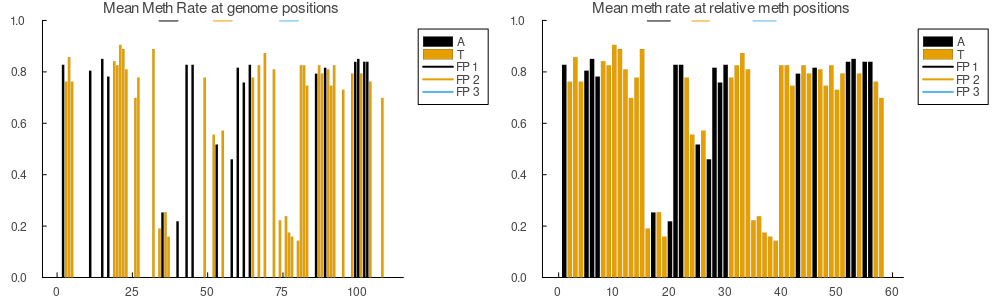

In [19]:
### Here is how we can generate a sample, calculate footprint level stats and then plot that information 
smf_sample = sample_smf_AT(bindingconfig(hk1desc, config_57), nreads=150, open_meth_prob=open_meth_prob, closed_meth_prob=closed_meth_prob, frprob=frprob);
smf_stats = smf_sample_stats(smf_sample)
plot_footprint_level_sample(smf_stats)

In [20]:
### in general I will run this all in one line a sample of config 57:
smf_sample_stats_57 = smf_sample_stats(sample_smf_AT(bindingconfig(hk1desc, config_57), nreads=150, open_meth_prob=open_meth_prob, closed_meth_prob=closed_meth_prob, frprob=frprob));

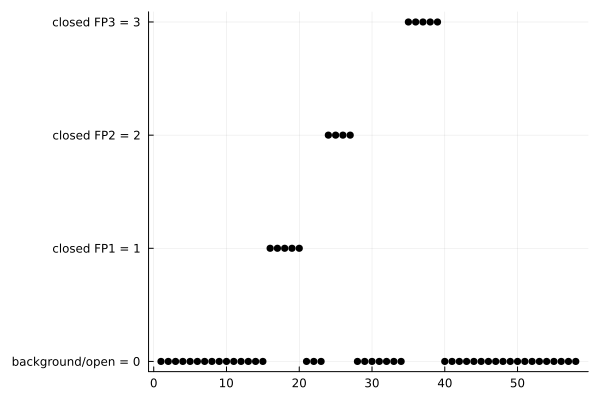

In [21]:
### we will make use of the indcator variable smf_sample_stats_57.footprints
### in this variable, 0 = base is in background/open/accesible, 1 = base is in footprint 1, and so on
scatter(smf_sample_stats_57.footprints, lab="", yticks=(0:3, ["background/open = 0", "closed FP1 = 1", "closed FP2 = 2", "closed FP3 = 3"]))

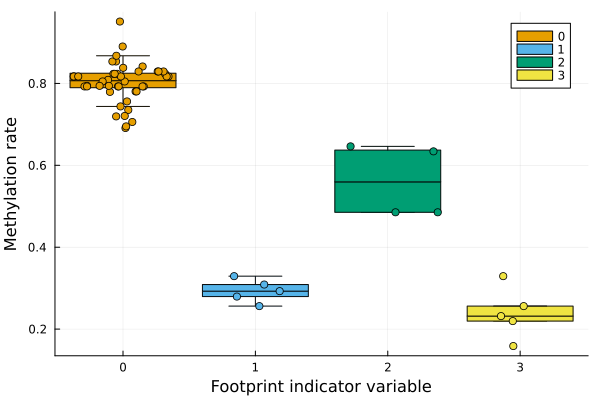

In [22]:
### we can see how this footprintids variable cooresponds to the observed methylation rate
boxplot(smf_sample_stats_57.footprints, smf_sample_stats_57.methrate, group=smf_sample_stats_57.footprints, outliers=false, c=[2 3 4 5])
dotplot!(smf_sample_stats_57.footprints, smf_sample_stats_57.methrate, group=smf_sample_stats_57.footprints, outliers=false, c=[2 3 4 5], lab="")
plot!(xlabel="Footprint indicator variable", ylabel="Methylation rate")

## Model 1

For model 1, we will call this fp_depth, efine a model in `Turing.jl` using `@model` macro. 
  - This model will be very easy. Assume that indicator variable `footprints` is known, but the underlying methylation rates of the background and each footprint is not.
  - Set a `Beta(1, 1)` prior over the methylation rates `meth_p` for background, FP1, FP2, and FP2
  - For each position, the total count of methylated bases `totalmeth` will be follow a Binomial distribution with methylation rate and the number number of reads sequenced that span that base `total`

In [23]:
fp_model1(sample) = fp_depth(sample.footprints, sample.totalmeth, sample.total)

@model function fp_depth(footprints, totalmeth, total)
    meth_p ~ filldist(Beta(1, 1), 4)
    for i = 1:length(footprints)
         totalmeth[i] ~ Binomial(total[i], meth_p[footprints[i]+1])
    end
    meth_p
end

### The above model can be implemented without the for loop as follows using broadcasting
# @model function fp_depth_broadcast(footprints, totalmeth, total)
#     meth_p ~ filldist(Beta(1, 1), 4)
#     totalmeth .~ Binomial.(total, getindex.(Ref(meth_p), footprints .+ 1))
# end

fp_depth (generic function with 2 methods)

#### Inference on model 1

We can run MCMC inference on model 1 very straightforwardly using Turing.jl. We use the function `sample` and we give it the model, a sampler and the number of iterations and it samples an MCMC chain.

Lets try two samplers, both Hamiltonian Monte Carlo derivative
 1. NUTS - No U-turn sampler (with default parametes)
 2. HMC(ϵ, n_leapfrog) - a hamiltonian monte carlo sampler `ϵ` =  The leapfrog step size to use, `n_leapfrog` =  The number of leapfrog steps to use.
 
 General introduction to both can be found: https://en.wikipedia.org/wiki/Hamiltonian_Monte_Carlo, also Turing.jl docs: https://turinglang.org/
 
 

In [24]:
@time fp_chain_nuts = sample(fp_model1(smf_sample_stats_57), NUTS(), 10000)
@time fp_chain_hmc = sample(fp_model1(smf_sample_stats_57), HMC(0.05, 10), 10000);

┌ Info: Found initial step size
└   ϵ = 0.05
Sampling: 100%|█████████████████████████████████████████| Time: 0:00:00


  7.200188 seconds (32.63 M allocations: 2.226 GiB, 6.16% gc time, 92.75% compilation time)


Sampling: 100%|█████████████████████████████████████████| Time: 0:00:00


  2.138714 seconds (8.20 M allocations: 620.236 MiB, 19.99% gc time, 69.16% compilation time)


Plot some statistics on the chain:

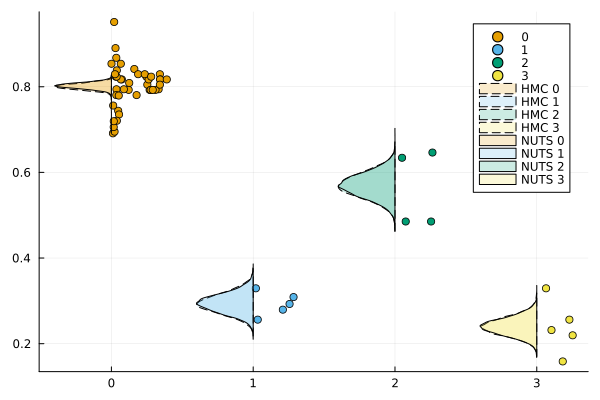

In [25]:
n = length(unique(smf_sample_stats_57.footprints)) 
plot()
dotplot!(smf_sample_stats_57.footprints, smf_sample_stats_57.methrate, group=smf_sample_stats_57.footprints, outliers=false, c=(1:n)' .+ 1, side=:right)
violin!((0:(n-1))', [fp_chain_hmc["meth_p[$i]"] for i = 1:n],    c=(1:n)' .+ 1, fillalpha=0.2, side=:left, ls=:dash, lab=string.("HMC ", (1:n)' .- 1))
violin!((0:(n-1))', [fp_chain_nuts["meth_p[$i]"] for i = 1:n],   c=(1:n)' .+ 1, fillalpha=0.2, side=:left, lab=string.("NUTS ", (1:n)' .- 1))

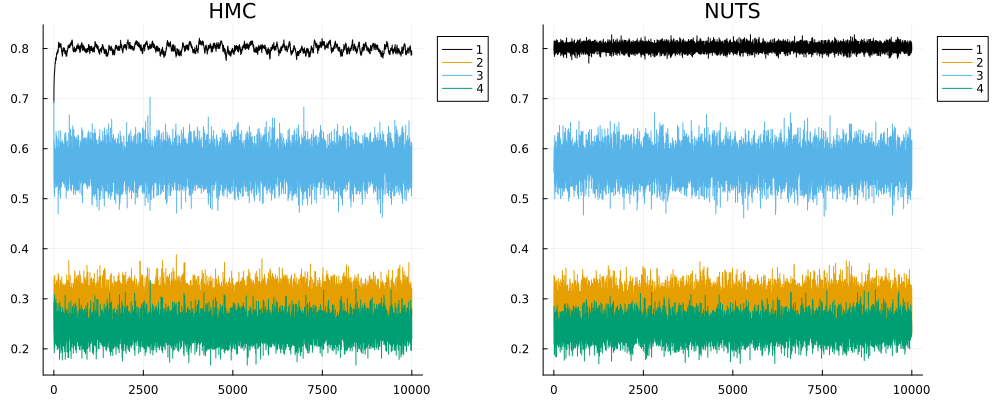

In [26]:
### visualise the chains
p_hmc = plot()
for i = 1:4
    plot!(fp_chain_hmc["meth_p[$i]"], lab="$i", title="HMC")
end
p_nuts = plot()
for i = 1:4
    plot!(fp_chain_nuts["meth_p[$i]"], lab="$i", title="NUTS")
end
plot(p_hmc, p_nuts, link=:y, leg=:outertopright, size=(1000, 400))

### Model 2

Model 1 is overly simple, it knows where the footprints are and it could estimate the parameters for each independently.

Lets build a model in which the footprint locations are inferred! This will be model two.

First lets start with `model2A` a model that only infers the position of one footprint.

We also need a convenience function that makes an indicator variable as to whether each position is part of a footprint.

#### Modelling footprints positions as continuous variables

Our measurements of footprints occur at discrete positions on the genome. In inference models of footprint locations we could sample from discrete distributions to identify the locations of the footprints, this would require us to use discrete samplers Metropolis Hastings `MH()` or Particle Gibbs `PG()`. These discrete samplers are significantly slower than continuous samplers that employ gradient based information, e.g. `HMC` and related samplers. Also the TFs move in continous space and we could imagine a TF partially occluding a base. 


In [60]:
### Convenience function that makes an indicator variable as to whether each position is part of a footprint

"""
    footprintvec(start, footprint_lengths, footprint_intervals, n) ### round continuous variables to ints

        This function will round any continuous variables to integers. This allows us to sample
        `start` - The left position of the first footprint - can be floating point 
        `footprint_lengths` - Vector of lengths of footprints
        `footprint_intervals` - Vector of intervals between footprints
        `n` - length of sequence that can contain the footprints

    This function calcualtes an indicator variable `footprints` which is the length of the sequence `n`. If we have `k` footprints
    `footprints[i] ∈ {0, 1, ..., k}' with 0 indicating that base is not in a footprint, and 1, ..., k indicating a base is in one of the footprints.
    

"""
function footprintvec(start, footprint_lengths, footprint_intervals, n) ### round continuous variables to ints

    footprints = zeros(Int, n) ### setup indicator variable
    
    pos = start ## we are going to increment variable pos as we move through the footprints
    for i = 1:length(footprint_lengths) ## loop ofer the footprint lengths
        
        
        fl = Int(round(footprint_lengths[i])) ### round footprint_lengths[i]
        ipos = Int(round(pos)) ### round the start footprint position, the leftmost base
    
        ind = intersect(ipos:(ipos + fl - 1), 1:length(footprints)) ### calculate which of the sequence positions intersect with footprint i
        footprints[ind] .= i
        
        ### increment pos by footprint length and the interval to the start of the next footprint if necessary
    
        pos += footprint_lengths[i]
        if i < length(footprint_lengths)
            pos += footprint_intervals[i]
        end
    end
    
    footprints
    
end
### note previous function in the first version of the repo, I realised I was over rounding
# function footprintvec(start, footprint_lengths, footprint_intervals, n) ### round continuous variables to ints

#     footprints = zeros(Int, n) ### setup indicator variable
#     pos = Int(round(start)) ### round the start footprint position, the leftmost base of the first footpring
    
#     for i = 1:length(footprint_lengths) ## loop ofer the footprint lengths
        
#         fl = Int(round(footprint_lengths[i])) ### round footprint_lengths[i]
        
#         ind = intersect(pos:(pos + fl - 1), 1:length(footprints)) ### calculate which of the sequence positions intersect with footprint i
#         footprints[ind] .= i
        
#         ### increment pos by footprint length and the interval to the start of the next footprint if necessary
#         pos += fl
#         if i < length(footprint_lengths)
#             pos += Int(round(footprint_intervals[i]))
#         end
#     end
    
#     footprints
    
# end



footprintvec

In [28]:
### a first model that only works if a single footprint

fp_model2A(sample) = fp_single(sample.totalmeth, sample.total)

@model function fp_single(totalmeth, total, min_footprint=0, min_interval=0)
    
    start              ~ Uniform(1, length(totalmeth)) ### where the footprint start
    footprint_length   ~ Gamma(5, 1) ### the footprint length ideally don't want to hard code the prior
    
    
    ### different meth priors for background (open regions) and footprints 
    ### open/background has higher prob of being methylated than footprints
    meth_bg ~ Beta(5, 2) ## methylation of background
    meth_fp ~ Beta(2, 5) ## methylation rate at each footprint and the background
    
    ### this function builds a footprint vector the same as footprints previously
    ### there is only one footprint here is the footprint_intervals vector is the empty vector Float64[]
    ### footprints is the same length as totalmeth, and 
    footprints = footprintvec(start, footprint_length .+ min_footprint, Float64[], length(totalmeth))
    
    
    ## Loop over the footprints sampling the total methylated bases at each position depending on whether base is in the footprint
    for i = 1:length(footprints)
        mp = (footprints[i] == 0) ? meth_bg : meth_fp[footprints[i]]
        totalmeth[i] ~ Binomial(total[i], mp)
    end
end


fp_single (generic function with 6 methods)

In [30]:
## we need a new sample for this model with only one TF
smf_sample_stats_tf1 = smf_sample_stats(sample_smf_AT(bindingconfig(hk1desc, config_tf1), nreads=150, open_meth_prob=open_meth_prob, closed_meth_prob=closed_meth_prob, frprob=frprob));

In [64]:

sampler = HMC(0.01, 5)
# sampler = NUTS()
fp_loc_chain_single = sample(fp_model2A(smf_sample_stats_tf1), sampler, 10_000); #only execute if sample has a single footpring

Sampling: 100%|█████████████████████████████████████████| Time: 0:00:00


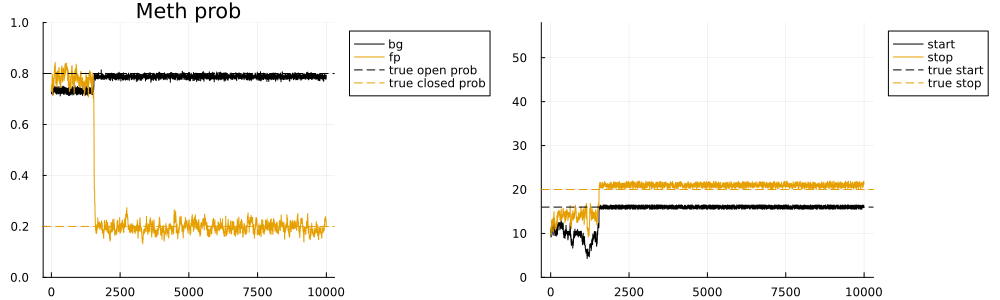

In [65]:


n = length(unique(smf_sample_stats_tf1.footprints))

p_meth = plot(ylims=(0, 1))
plot!(fp_loc_chain_single["meth_bg"], lab="bg", title="Meth prob")
plot!(fp_loc_chain_single["meth_fp"], lab="fp")
hline!([open_meth_prob], c=1, ls=:dash, lab="true open prob")
hline!([closed_meth_prob], c=2, ls=:dash, lab="true closed prob")

p_start = plot(fp_loc_chain_single["start"], lab="start", ylims=(0, length(smf_sample_stats_tf1.footprints)))
plot!(fp_loc_chain_single["footprint_length"] .+ fp_loc_chain_single["start"], lab="stop")

hline!(first.(smf_sample_stats_tf1.footprint_locations), ls=:dash, c=1, lab="true start")
hline!(last.(smf_sample_stats_tf1.footprint_locations), ls=:dash, c=2, lab="true stop")
plot(p_meth, p_start,layout=(1,2), size=(1000, 300), leg=:outertopright, fmt=:png)


Note this is a lot of variability in the sampling and it can get stuck in local optima. This is something we need to address.
Here is an example of a fairly good sample:

![Model2A good run](../images/model2A_hmc_good.png)

### Model 2B

Now lets try to learn the positions of multiple footprints!

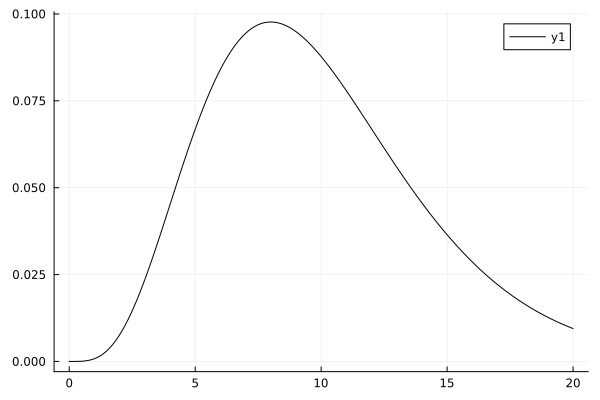

In [140]:
xp = range(0, 20, length= 1000)
plot(xp, pdf(Gamma(5, 2), xp))

In [141]:

function fp_model2B(sample)    
    totalfootprints = length(unique(sample.footprints)) - 1
    fp_multiple(totalfootprints, sample.totalmeth, sample.total)
end

@model function fp_multiple(totalfootprints, totalmeth, total, min_footprint=0, min_interval=0)
    start               ~ Beta(1, 4) ### where the footprints start
    footprint_lengths   ~ filldist(Gamma(5, 2), totalfootprints) ### ideally don't want to hard code the prior
    footprint_intervals ~ filldist(Gamma(5, 2), max(1, totalfootprints - 1)) ### space between the footprints
    
    
    ### different meth priors for background (open regions) and footprints 
    ### open/background has higher prob of being methylated than footprints
    meth_bg ~ Beta(5, 2) ## methylation of background
    meth_fp ~ filldist(Beta(2, 5), totalfootprints) ### methylation rate at each footprint and the background
    
    ### this function builds a footprint vector the same as footprints previously
    footprints = footprintvec(start*length(totalmeth), footprint_lengths .+ min_footprint, footprint_intervals .+ min_interval, length(totalmeth))
    
    
    ## loop as above, but split bg and fp
    for i = 1:length(footprints)
        mp = (footprints[i] == 0) ? meth_bg : meth_fp[footprints[i]]
        totalmeth[i] ~ Binomial(total[i], mp)
    end
end


fp_multiple (generic function with 6 methods)

In [142]:

sampler = HMC(0.01, 5)
# sampler = NUTS()
fp_loc_chain_multiple = sample(fp_model2B(smf_sample_stats_57), sampler, 5_000); 

Sampling: 100%|█████████████████████████████████████████| Time: 0:00:01


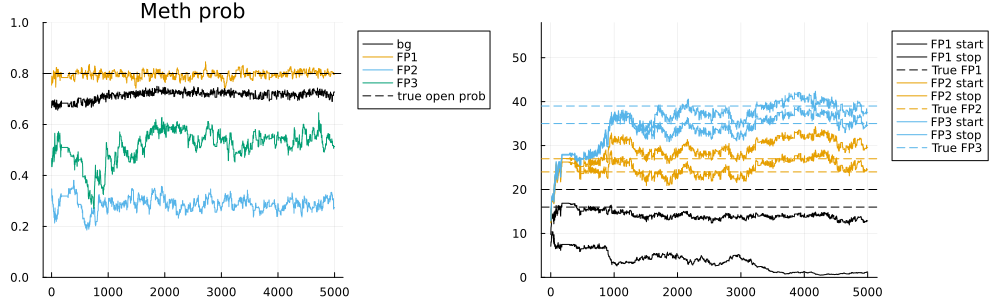

In [143]:
totalfootprints = length(unique(smf_sample_stats_57.footprints)) - 1

p_meth = plot(ylims=(0, 1))
plot!(fp_loc_chain_multiple["meth_bg"], lab="bg", title="Meth prob")
for i = 1:totalfootprints
    plot!(fp_loc_chain_multiple["meth_fp[$i]"], lab="FP$i")
end
hline!([open_meth_prob], c=1, ls=:dash, lab="true open prob")
# hline!([closed_meth_prob], c=2, ls=:dash, lab="true closed prob")

pos = fp_loc_chain_multiple["start"]*length(smf_sample_stats_57.totalmeth)
# p_start = plot(pos, lab="start")
p_start = plot()
for i = 1:totalfootprints
    plot!(pos, lab="FP$i start", c=i)
    pos .+= fp_loc_chain_multiple["footprint_lengths[$i]"]
    plot!(pos, lab="FP$i stop", c=i)
    if i < totalfootprints
       pos .+= fp_loc_chain_multiple["footprint_lengths[$i]"]
    end
    hline!([smf_sample_stats_57.footprint_locations[i]...], c=i, ls=:dash, lab="True FP$i")
end

yl = ylims()
plot!(ylims=(0, max(yl[2], length(smf_sample_stats_57.footprints))))
# plot!(fp_loc_chain_single["footprint_length"] .+ fp_loc_chain_single["start"], lab="stop")

# hline!(first.(smf_sample_stats_57.footprint_locations), ls=:dash, c=1, lab="true start")
# hline!(last.(smf_sample_stats_57.footprint_locations), ls=:dash, c=2, lab="true stop")
plot(p_meth, p_start,layout=(1,2), size=(1000, 300), leg=:outertopright, fmt=:png)


### Local optima issues
The sampler above tends to get stuck in local optima. I have previous had good performance of a closely related model to this and so I am not sure why it fails when the related model did not. To give an example, here is a trace in which it finds 2 of 3 footprints correctly:

![fp multiple 2 of 3 HMC](../images/model2d_hmc_2of3fp.png)

We can change the sampler to help it jump out of local optima. This is a place where Turing.jl is powerful.
  - Assign variables to different samplers `start` and `footprint_intervals` are assigned to a metropolis hastings sampler with a proposal distribution
  - All other variables assigned to `HMC(0.01, 5)`
  - Use Gibbs sampling to alternate sampling on each conditional on the previous sample https://en.wikipedia.org/wiki/Gibbs_sampling
  - Use a mixture model random walk for `start` and `footprint_intervals`
     - With probability `1-p` jump from current position by `Normal(0, 0.2)`
     - With probability `(1-p)/2` jump to left `Normal(-δ, 0.2)`
     - With probability `(1-p)/2` jump to right `Normal(δ, 0.2)`
     - p = 0.05
     - δ = 10
  



In [157]:
δ = 10
p = 0.05
sampler = Gibbs(MH(:start => x -> MixtureModel(Normal.([x - δ, x, x + δ], 0.2), [p/2, 1-p, p/2]),
                   :footprint_intervals => a -> [MixtureModel(Normal.([x - δ, x, x + δ], 0.2), [p/2, 1-p, p/2]) for x in a])
                    , HMC(0.01, 5,));


In [164]:
fp_loc_chain_multiple = sample(fp_model2B(smf_sample_stats_57), sampler, 5_000); 

Sampling: 100%|█████████████████████████████████████████| Time: 0:00:01


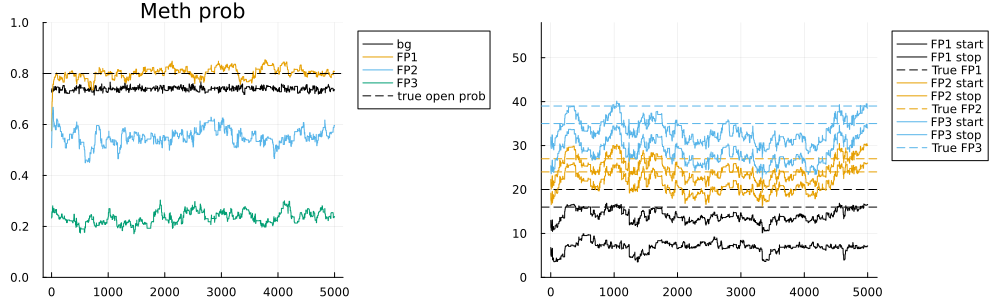

In [165]:
totalfootprints = length(unique(smf_sample_stats_57.footprints)) - 1

p_meth = plot(ylims=(0, 1))
plot!(fp_loc_chain_multiple["meth_bg"], lab="bg", title="Meth prob")
for i = 1:totalfootprints
    plot!(fp_loc_chain_multiple["meth_fp[$i]"], lab="FP$i")
end
hline!([open_meth_prob], c=1, ls=:dash, lab="true open prob")
# hline!([closed_meth_prob], c=2, ls=:dash, lab="true closed prob")

pos = fp_loc_chain_multiple["start"]*length(smf_sample_stats_57.totalmeth)
# p_start = plot(pos, lab="start")
p_start = plot()
for i = 1:totalfootprints
    plot!(pos, lab="FP$i start", c=i)
    pos .+= fp_loc_chain_multiple["footprint_lengths[$i]"]
    plot!(pos, lab="FP$i stop", c=i)
    if i < totalfootprints
       pos .+= fp_loc_chain_multiple["footprint_lengths[$i]"]
    end
    hline!([smf_sample_stats_57.footprint_locations[i]...], c=i, ls=:dash, lab="True FP$i")
end

yl = ylims()
plot!(ylims=(0, max(yl[2], length(smf_sample_stats_57.footprints))))
# plot!(fp_loc_chain_single["footprint_length"] .+ fp_loc_chain_single["start"], lab="stop")

# hline!(first.(smf_sample_stats_57.footprint_locations), ls=:dash, c=1, lab="true start")
# hline!(last.(smf_sample_stats_57.footprint_locations), ls=:dash, c=2, lab="true stop")
plot(p_meth, p_start,layout=(1,2), size=(1000, 300), leg=:outertopright, fmt=:png)


Unforunately this still performs poorly.

# Commented in detail to here. I need to rework some of the notebook below
----

Continue passed this point with caution

In [166]:

@model function fp_multiple_starts(totalfootprints, totalmeth, total, min_footprint=0, min_interval=0)
    starts              ~ filldist(Uniform(1, length(totalmeth)), totalfootprints) ### where the footprints start
    footprint_lengths   ~ filldist(Gamma(5, 1), totalfootprints) ### ideally don't want to hard code the prior
    # footprint_intervals ~ filldist(Gamma(5, 1), min(1, totalfootprints - 1)) ### space between the footprints
    
    
    ### different meth priors for background (open regions) and footprints 
    ### open/background has higher prob of being methylated than footprints
    meth_bg ~ Beta(5, 2) ## methylation of background
    meth_fp ~ filldist(Beta(2, 5), totalfootprints) ### methylation rate at each footprint and the background
    
    ### this function builds a footprint vector the same as footprints previously
    footprints = footprintvec_starts(starts, footprint_lengths .+ min_footprint, length(totalmeth))
    
    
    ## loop as above, but split bg and fp
    for i = 1:length(footprints)
        mp = (footprints[i] == 0) ? meth_bg : meth_fp[footprints[i]]
        totalmeth[i] ~ Binomial(total[i], mp)
    end
end


function footprintvec_starts(starts, footprint_lengths, n)

    footprints = zeros(Int, n)
    
    for i = 1:length(footprint_lengths)
        p = Int(round(starts[i]))
        fl = Int(round(footprint_lengths[i]))
        ind = intersect(p:(p + fl - 1), 1:length(footprints))
        footprints[ind] .= i
    end
    footprints
end


footprintvec_starts (generic function with 1 method)

In [628]:
δ = 5
p = 0.1
sampler = Gibbs(MH(:starts => x -> [MixtureModel(Normal.([v - δ, v, v + δ], 0.2), [p/2, 1-p, p/2]) for v in x]), HMC(0.01, 5,))
sampler = Gibbs(MH(:starts => x -> [MixtureModel(Normal.([v - δ, v, v + δ], 0.2), [p/2, 1-p, p/2]) for v in x]), NUTS())
# sampler = HMC(0.01, 10)
# sampler = NUTS()
@time fp_loc_chain = sample(fp_multiple(2, totalmeth, total), sampler, 5000);

┌ Info: Found initial step size
└   ϵ = 0.05
Sampling: 100%|█████████████████████████████████████████| Time: 0:00:01


  2.725569 seconds (13.30 M allocations: 1.344 GiB, 4.01% gc time, 52.14% compilation time)


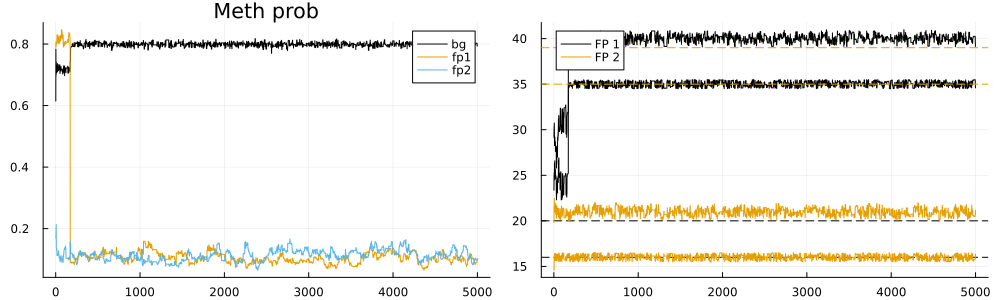

In [629]:
n = length(unique(footprints)) - 1

p_hmc = plot()
plot!(fp_loc_chain["meth_bg"], lab="bg", title="Meth prob")
for i = 1:n
    plot!(fp_loc_chain["meth_fp[$i]"], lab="fp$i")
end
p_hmc

p_pos = plot()
for i = 1:n
    plot!(fp_loc_chain["starts[$i]"], lab="", c=i)
    plot!(fp_loc_chain["starts[$i]"] .+ fp_loc_chain["footprint_lengths[$i]"], lab="FP $i", c=i)
    hline!([footprint_locations[i][1]], ls=:dash, c=i, lab="")
    hline!([footprint_locations[i][2]], ls=:dash, c=i, lab="")
end
plot(p_hmc, p_pos, size=(1000, 300))

In [634]:
@model function fp_loc(totalfootprints, totalmeth, total, min_footprint=0, min_interval=0)
    start               ~ Uniform(1, length(totalmeth)) ### where the footprints start
    footprint_lengths   ~ filldist(Gamma(5, 1), totalfootprints) ### ideally don't want to hard code the prior
    footprint_intervals ~ filldist(Gamma(5, 1), min(1, totalfootprints - 1)) ### space between the footprints
    
    
    ### different meth priors for background (open regions) and footprints 
    ### open/background has higher prob of being methylated than footprints
    meth_bg ~ Beta(5, 2) ## methylation of background
    meth_fp ~ filldist(Beta(2, 5), totalfootprints) ### methylation rate at each footprint and the background
    
    ### this function builds a footprint vector the same as footprints previously
    footprints = footprintvec(start, footprint_lengths .+ min_footprint, footprint_intervals .+ min_interval, length(totalmeth))
    
    
    ## loop as above, but split bg and fp
    for i = 1:length(footprints)
        mp = (footprints[i] == 0) ? meth_bg : meth_fp[footprints[i]]
        totalmeth[i] ~ Binomial(total[i], mp)
    end
end


### function to build a vector of integers of footprint locations
function footprintvec(start, footprint_lengths, footprint_intervals, n) ### round continuous variables to ints
    footprints = zeros(Int, n)
    pos = Int(round(start))
    
    for i = 1:length(footprint_lengths)
        
        fl = Int(round(footprint_lengths[i]))
        
        ind = intersect(pos:(pos + fl - 1), 1:length(footprints))
        footprints[ind] .= i
        pos += fl
        if i < length(footprint_lengths)
            pos += Int(round(footprint_intervals[i]))
        end
    end
    
    footprints
    
end



### useful function for generating a footprint vector from a chain
function fp_vec_chain(chain, k, n, num_footprints=2)
    fls = [chain["footprint_lengths[$i]"][k] for i = 1:num_footprints]
    fiv = [chain["footprint_intervals[$i]"][k] for i = 1:(num_footprints-1)]
    footprintvec(chain["start"][k], fls, fiv, n)
end

fp_vec_chain (generic function with 3 methods)

In [653]:
### Gibbs sampler for random walk metropolis hastings for start position and footprint positions
### HMC for methylation probabilities


δ = 10
p = 0.1
sampler = Gibbs(MH(:start => x -> MixtureModel(Normal.([x-δ, x, x+δ], 0.2), [p/2, 1-p, p/2])),
                MH(:footprint_lengths => x -> [Normal(v, 0.2) for v in x], :footprint_intervals => x -> [Normal(v, 0.2) for v in x]),
                HMC(0.01, 5, :meth_bg, :meth_fp))

# sampler = Gibbs(MH(:starts => x -> [MixtureModel(Normal.([v - δ, v, v + δ], 0.2), [p/2, 1-p, p/2]) for v in x]), HMC(0.01, 5,))
# sampler = Gibbs(MH(:start => x -> MixtureModel(Normal.([x - δ, x, x + δ], 0.2), [p/2, 1-p, p/2])), NUTS())
# sampler = HMC(0.01, 10)
# sampler = NUTS()

@time fp_loc_chain = sample(fp_loc(2, totalmeth, total), sampler, 5000);

Sampling: 100%|█████████████████████████████████████████| Time: 0:00:01


  3.509283 seconds (15.62 M allocations: 1.184 GiB, 3.49% gc time, 51.18% compilation time)


The model above performs ok, just ok, sometimes it gets the footprints more or less right and so the probabilities are ok, but its a highly multimodal likelihood landscape and so it gets stuck in a local optima

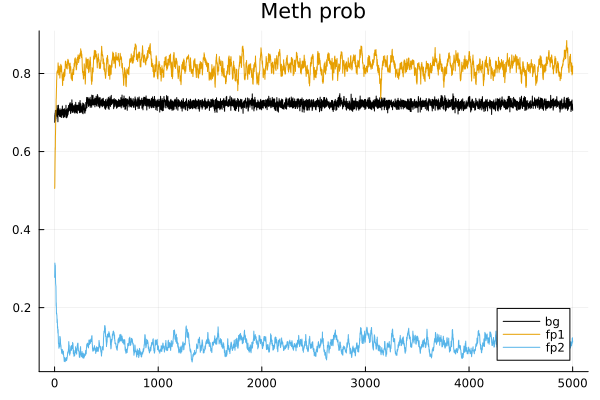

In [654]:
p_hmc = plot()
plot!(fp_loc_chain["meth_bg"], lab="bg", title="Meth prob")
for i = 1:n
    plot!(fp_loc_chain["meth_fp[$i]"], lab="fp$i")
end
p_hmc

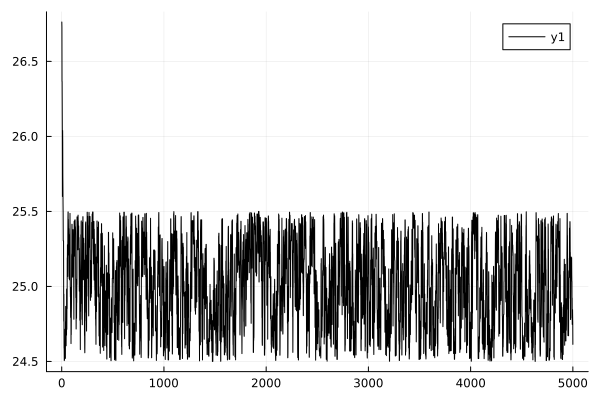

In [655]:
plot(fp_loc_chain["start"])

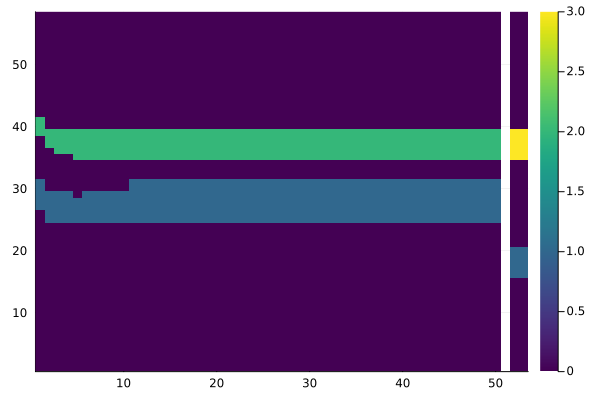

In [656]:
### visualise locations of the footprints, the RHS gives the correct positions
heatmap([mapreduce(i -> fp_vec_chain(fp_loc_chain, i, length(methrate), 2), hcat, 1:100:length(fp_loc_chain)) footprints.*NaN footprints footprints])

### Model 3

Despite model 2 performing poorly, lets move onto model 3, with the hope that adding details will aid the inference.

In the next iteration, lets switch the coordinate system to the true coordinate system. Currently we are generating the positions of footprints and their sizes on the indexes of A/T positions, and not on their true genomic coordinates.



In [320]:

function footprintvec_genome(start, footprint_lengths, footprint_intervals, positions, seqlength) 
    footprints = zeros(Int, length(positions))
    pos = start
    fpmark = 1
    for i = 1:length(footprint_lengths)
        
        for j = fpmark:length(positions)
            if pos <= positions[j] <= (pos + footprint_lengths[i])
                footprints[j] = i
                fpmark = i
            end
        end
        pos += footprint_lengths[i]
        
        if i < length(footprint_lengths)
            pos += Int(round(footprint_intervals[i]))
        end
    end
    
    footprints
    
end


### useful function for generating a footprint vector from a chain
function fp_vec_genome_chain(chain, k, n, num_footprints=3, start=16)
    fls = [chain["footprint_lengths[$i]"][k] for i = 1:num_footprints]
    fiv = [chain["footprint_intervals[$i]"][k] for i = 1:(num_footprints-1)]
    footprintvec(start, fls, fiv, n)
end

footprintvec_genome (generic function with 1 method)

In [418]:
@model function fp_genomepos(totalfootprints, positions, seqlength, totalmeth, total, min_footprint=0, min_interval=0)
    start               ~ Uniform(1, seqlength/2) ### where the footprints start
    footprint_lengths   ~ filldist(Gamma(5, 2), totalfootprints) ### ideally don't want to hard code the prior
    footprint_intervals ~ filldist(Gamma(6, 2), totalfootprints - 1) ### space between the footprints
    
    
    ### different meth priors for background (open regions) and footprints 
    ### open/background has higher prob of being methylated than footprints
    meth_bg ~ Beta(5, 2) ## methylation of background
    meth_fp ~ filldist(Beta(2, 5), totalfootprints) ### methylation rate at each footprint and the background
    
    ### this function builds a footprint vector the same as footprints previously
    footprints = footprintvec_genome(start, footprint_lengths .+ min_footprint, footprint_intervals .+ min_interval, positions, seqlength)
    
    
    ## loop as above, but split bg and fp
    for i = 1:length(footprints)
        mp = (footprints[i] == 0) ? meth_bg : meth_fp[footprints[i]]
        totalmeth[i] ~ Binomial(total[i], mp)
    end
end


fp_genomepos (generic function with 8 methods)

In [427]:

δ = 5
p = 0.1
sampler = Gibbs(MH(:start => x -> MixtureModel(Normal.([-δ, 0, +δ], 0.2), [p/2, 1-p, p/2]),
                :footprint_lengths => x -> fill(Normal(0, 0.2), length(x)), :footprint_intervals => x -> [Normal(0, 0.2) for v in x]),
                HMC(0.01, 5, :meth_bg, :meth_fp))

sampler = HMC(0.01, 5)
@time fp_gen_chain = sample(fp_genomepos(3, positions, length(hk1desc.seq), totalmeth, total), sampler, 10000);

Sampling: 100%|█████████████████████████████████████████| Time: 0:00:02


  2.293956 seconds (12.14 M allocations: 1.117 GiB, 5.48% gc time)


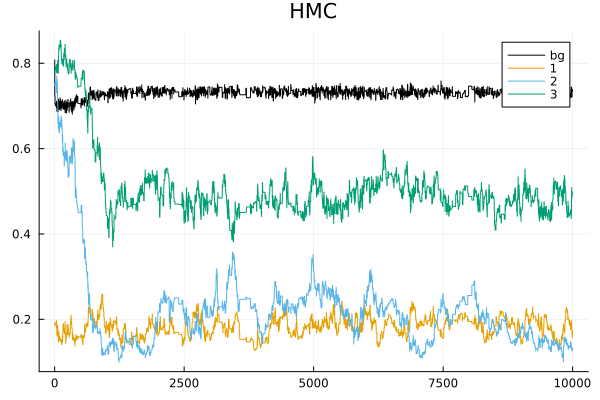

In [428]:
p_hmc = plot()
plot!(fp_gen_chain["meth_bg"], lab="bg", title="HMC")

for i = 1:3
    plot!(fp_gen_chain["meth_fp[$i]"], lab="$i", title="HMC")
end
p_hmc

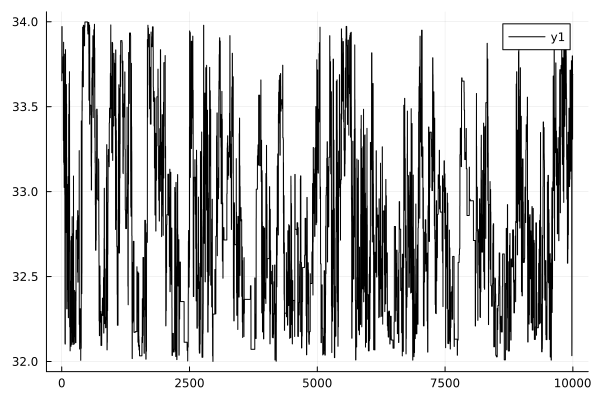

In [429]:
plot(fp_gen_chain["start"])

In [606]:
@time fp_chain_nuts = sample(fp_depth(footprints, totalmeth, total), NUTS(), 10000)
@time fp_chain_hmc = sample(fp_depth(footprints, totalmeth, total), HMC(0.05, 10), 10000);

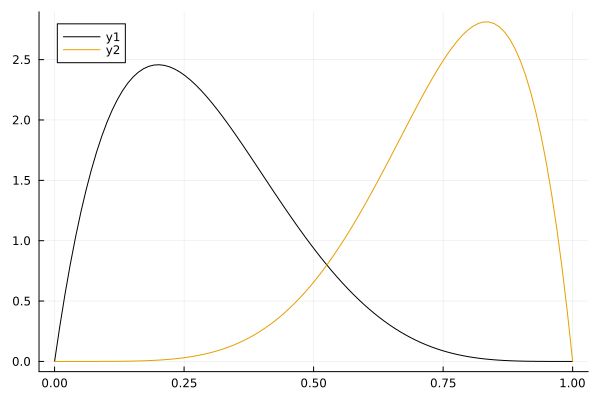

In [745]:
bins = range(0, 1, length=100)
plot(bins, pdf.(Beta(2, 5), bins))
plot!(bins, pdf.(Beta(6, 2), bins))

In [678]:
DiscreteUniform(1, 10) |> rand

6

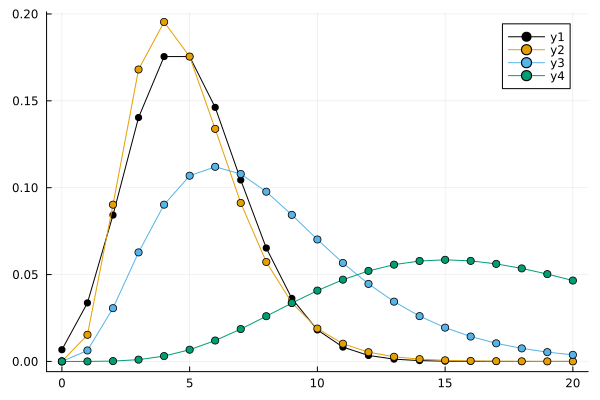

In [345]:
bins = 0:20
plot(bins, pdf.(Poisson(5), bins), marker=:circle)
# plot!(bins, pdf.(Erlang(3, 2), bins), marker=:circle)
plot!(bins, pdf.(Gamma(5, 1), bins), marker=:circle)
plot!(bins, pdf.(Gamma(4, 2), bins), marker=:circle)
plot!(bins, pdf.(Gamma(6, 3), bins), marker=:circle)